# Integrantes:

### * Mariana Ceballos
### * Felipe Londoño
### * Federico Arango
### * Daniel Elorza

In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
from sklearn.preprocessing import LabelEncoder  # Importar LabelEncoder

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
from sklearn.preprocessing import LabelEncoder  # Importar LabelEncoder

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


/kaggle/input/tiny-imagenet/tiny-imagenet-200/words.txt
/kaggle/input/tiny-imagenet/tiny-imagenet-200/wnids.txt
/kaggle/input/tiny-imagenet/tiny-imagenet-200/tiny-imagenet-200/words.txt
/kaggle/input/tiny-imagenet/tiny-imagenet-200/tiny-imagenet-200/wnids.txt
/kaggle/input/tiny-imagenet/tiny-imagenet-200/tiny-imagenet-200/val/val_annotations.txt
/kaggle/input/tiny-imagenet/tiny-imagenet-200/tiny-imagenet-200/val/images/val_5946.JPEG
/kaggle/input/tiny-imagenet/tiny-imagenet-200/tiny-imagenet-200/val/images/val_861.JPEG
/kaggle/input/tiny-imagenet/tiny-imagenet-200/tiny-imagenet-200/val/images/val_2052.JPEG
/kaggle/input/tiny-imagenet/tiny-imagenet-200/tiny-imagenet-200/val/images/val_7973.JPEG
/kaggle/input/tiny-imagenet/tiny-imagenet-200/tiny-imagenet-200/val/images/val_3503.JPEG
/kaggle/input/tiny-imagenet/tiny-imagenet-200/tiny-imagenet-200/val/images/val_1018.JPEG
/kaggle/input/tiny-imagenet/tiny-imagenet-200/tiny-imagenet-200/val/images/val_6416.JPEG
/kaggle/input/tiny-imagenet/ti

In [2]:
DIR_MAIN = '/kaggle/input/tiny-imagenet/tiny-imagenet-200/'
DIR_TRAIN = DIR_MAIN + 'train/'
DIR_VAL = DIR_MAIN + 'val/'
DIR_TEST = DIR_MAIN + 'test/'

# Number of labels - 200
labels = os.listdir(DIR_TRAIN)

# Initialize labels encoder
encoder_labels = LabelEncoder()
encoder_labels.fit(labels)

# Train
files_train = []
labels_train = []
for label in labels:
    for filename in os.listdir(DIR_TRAIN + label + '/images/'):
        files_train.append(DIR_TRAIN + label + '/images/' + filename)
        labels_train.append(label)

# Val
files_val = []
labels_val = []
for filename in os.listdir(DIR_VAL + 'images/'):
    files_val.append(DIR_VAL + 'images/' + filename)

val_df = pd.read_csv(DIR_VAL + 'val_annotations.txt', sep='\t', names=["File", "Label", "X1", "Y1", "X2", "Y2"], usecols=["File", "Label"])
for f in files_val:
    l = val_df.loc[val_df['File'] == f[len(DIR_VAL + 'images/'):]]['Label'].values[0]
    labels_val.append(l)

# Test
files_test = []
for filename in os.listdir(DIR_TEST + 'images/'):
    files_test.append(DIR_TEST + 'images/' + filename)
    files_test = sorted(files_test)
    
print("The first five files from the list of train images:", files_train[:5])
print("\nThe first five labels from the list of train labels:", labels_train[:5])
print("\nThe first five files from the list of validation images:", files_val[:5])
print("\nThe first five labels from the list of validation labels:", labels_val[:5])
print("\nThe first five files from the list of test images:", files_test[:5])

The first five files from the list of train images: ['/kaggle/input/tiny-imagenet/tiny-imagenet-200/train/n02437312/images/n02437312_229.JPEG', '/kaggle/input/tiny-imagenet/tiny-imagenet-200/train/n02437312/images/n02437312_394.JPEG', '/kaggle/input/tiny-imagenet/tiny-imagenet-200/train/n02437312/images/n02437312_15.JPEG', '/kaggle/input/tiny-imagenet/tiny-imagenet-200/train/n02437312/images/n02437312_62.JPEG', '/kaggle/input/tiny-imagenet/tiny-imagenet-200/train/n02437312/images/n02437312_17.JPEG']

The first five labels from the list of train labels: ['n02437312', 'n02437312', 'n02437312', 'n02437312', 'n02437312']

The first five files from the list of validation images: ['/kaggle/input/tiny-imagenet/tiny-imagenet-200/val/images/val_5946.JPEG', '/kaggle/input/tiny-imagenet/tiny-imagenet-200/val/images/val_861.JPEG', '/kaggle/input/tiny-imagenet/tiny-imagenet-200/val/images/val_2052.JPEG', '/kaggle/input/tiny-imagenet/tiny-imagenet-200/val/images/val_7973.JPEG', '/kaggle/input/tiny-i

In [3]:
import os
import numpy as np
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt
from tqdm import tqdm
import copy
from sklearn.preprocessing import LabelEncoder

import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, models

In [4]:
class ImagesDataset(Dataset):
    def __init__(self, files, labels, encoder, transforms, mode):
        super().__init__()
        self.files = files
        self.labels = labels
        self.encoder = encoder
        self.transforms = transforms
        self.mode = mode

    def __len__(self):
        return len(self.files)

    def __getitem__(self, index):
        pic = Image.open(self.files[index]).convert('RGB')

        if self.mode == 'train' or self.mode == 'val':
            x = self.transforms(pic)
            label = self.labels[index]
            y = self.encoder.transform([label])[0]
            return x, y
        elif self.mode == 'test':
            x = self.transforms(pic)
            return x, self.files[index]
        
transforms_train = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    transforms.Normalize([0.4802, 0.4481, 0.3975], [0.2302, 0.2265, 0.2262]),
    transforms.RandomErasing(p=0.5, scale=(0.06, 0.08), ratio=(1, 3), value=0, inplace=True)
])

transforms_val = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize([0.4802, 0.4481, 0.3975], [0.2302, 0.2265, 0.2262])
])

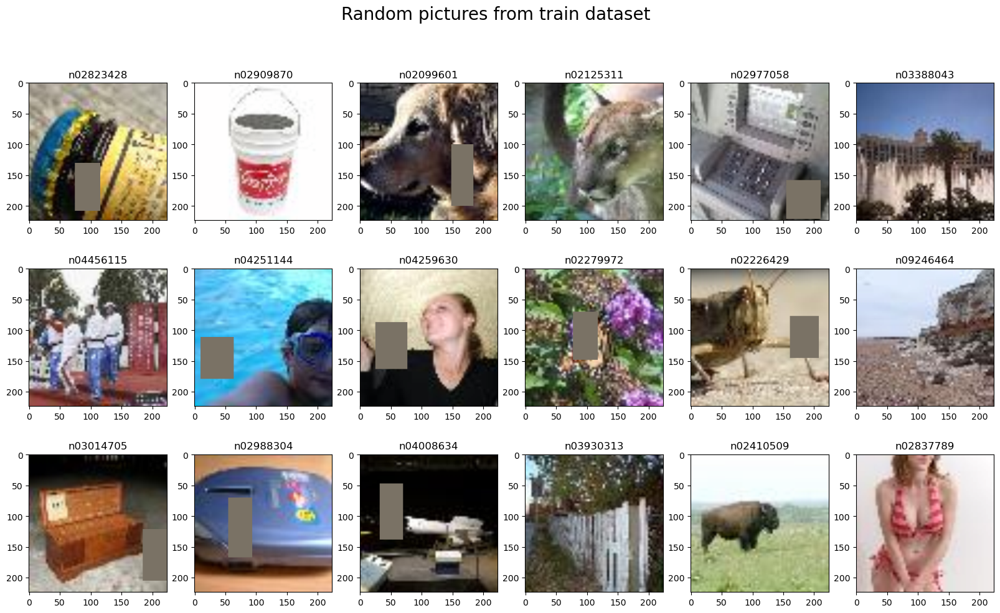

In [5]:
train_dataset = ImagesDataset(files=files_train,
                              labels=labels_train,
                              encoder=encoder_labels,
                              transforms=transforms_train,
                              mode='train')

val_dataset = ImagesDataset(files=files_val,
                            labels=labels_val,
                            encoder=encoder_labels,
                            transforms=transforms_val,
                            mode='val')

test_dataset = ImagesDataset(files=files_test,
                             labels=None,
                             encoder=None,
                             transforms=transforms_val,
                             mode='test')

fig, axs = plt.subplots(3, 6, figsize=(20,11))
fig.suptitle('Random pictures from train dataset', fontsize=20)
for ax in axs.flatten():
    n = np.random.randint(len(train_dataset))
    img = train_dataset[n][0]
    img = img.numpy().transpose((1, 2, 0))
    mean = np.array([0.4802, 0.4481, 0.3975])
    std = np.array([0.2302, 0.2265, 0.2262])
    img = std * img + mean
    img = np.clip(img, 0, 1)
    ax.set_title(encoder_labels.inverse_transform([train_dataset[n][1]])[0])
    ax.imshow(img)

# 1. Crear un DataGenerator personalizado para el conjunto de datos

In [6]:
import os
import numpy as np
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.preprocessing.image import load_img, img_to_array

/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/__init__.py:98: UserWarning: unable to load libtensorflow_io_plugins.so: unable to open file: libtensorflow_io_plugins.so, from paths: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so']
caused by: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so: undefined symbol: _ZN3tsl6StatusC1EN10tensorflow5error4CodeESt17basic_string_viewIcSt11char_traitsIcEENS_14SourceLocationE']
  warnings.warn(f"unable to load libtensorflow_io_plugins.so: {e}")
/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/__init__.py:104: UserWarning: file system plugins are not loaded: unable to open file: libtensorflow_io.so, from paths: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io.so']
caused by: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io.so: undefined symbol: _ZTVN10tenso

In [7]:
data_dir = '/kaggle/input/tiny-imagenet/tiny-imagenet-200/'  
train_dir = os.path.join(data_dir, 'train')
val_dir = os.path.join(data_dir, 'val')
test_dir = os.path.join(data_dir, 'test')
image_size = (64, 64)  # Tamaño de las imágenes
batch_size = 32
num_classes = 200  # Número de categorías en TinyImageNet

In [8]:
def load_data(directory):
    image_paths = []
    labels = []

# Asegúrate de que solo se consideren archivos con extensión .JPEG
    for img_name in os.listdir(directory):
        if img_name.endswith(".JPEG"):
            img_path = os.path.join(directory, img_name)
            image_paths.append(img_path)
            # Extrae la etiqueta del nombre del archivo
            label = img_name.split("_")[0]
            labels.append(label)

    return image_paths, labels

In [9]:
train_image_paths, train_labels = load_data(train_dir)
val_image_paths, val_labels = load_data(val_dir)

In [10]:
# Función para el generador de datos personalizado
def data_generator(image_paths, labels, image_size, num_classes, batch_size):
    num_samples = len(image_paths)
    while True:
        indices = np.arange(num_samples)
        np.random.shuffle(indices)
        
        for start in range(0, num_samples, batch_size):
            end = min(start + batch_size, num_samples)
            batch_indices = indices[start:end]
            
            batch_image_paths = [image_paths[i] for i in batch_indices]
            batch_labels = [labels[i] for i in batch_indices]
            
            X_batch = []
            y_batch = []
            
            for image_path, label in zip(batch_image_paths, batch_labels):
                img = load_img(image_path, target_size=image_size)
                img = img_to_array(img)
                img = img / 255.0  # Normalización
                X_batch.append(img)
                y_batch.append(int(label))
            
            X_batch = np.array(X_batch)
            y_batch = to_categorical(y_batch, num_classes=num_classes)
            
            yield X_batch, y_batch

In [11]:
train_generator = data_generator(train_image_paths, train_labels, image_size, num_classes, batch_size)
val_generator = data_generator(val_image_paths, val_labels, image_size, num_classes, batch_size)


# 2.Crear un modelo básico de red neuronal (utilizando dropout y batcnorm para regularizar)

In [12]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, BatchNormalization

# Crear un modelo secuencial
model = Sequential()

# Capa de convolución 1
model.add(Conv2D(32, (3, 3), activation='relu', input_shape=(64, 64, 3)))
model.add(MaxPooling2D((2, 2)))
model.add(BatchNormalization())

# Capa de convolución 2
model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(MaxPooling2D((2, 2)))
model.add(BatchNormalization())

# Capa de convolución 3
model.add(Conv2D(128, (3, 3), activation='relu'))
model.add(MaxPooling2D((2, 2)))
model.add(BatchNormalization())

# Capa de aplanamiento
model.add(Flatten())

# Capa completamente conectada 1
model.add(Dense(256, activation='relu'))
model.add(Dropout(0.5))  # Capa de Dropout para regularización

# Capa completamente conectada 2
model.add(Dense(200, activation='softmax'))  # 200 clases en TinyImageNet

# Compilar el modelo
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Resumen del modelo
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 62, 62, 32)        896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 31, 31, 32)       0         
 )                                                               
                                                                 
 batch_normalization (BatchN  (None, 31, 31, 32)       128       
 ormalization)                                                   
                                                                 
 conv2d_1 (Conv2D)           (None, 29, 29, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 14, 14, 64)       0         
 2D)                                                             
                                                        

# 3. Entrenar el modelo y mostrar el rendimiento en los conjuntos de entrenamiento, validación y prueba

In [23]:
# Entrenar el modelo
history = model.fit(
    train_generator,
    validation_data=val_generator,
    epochs=10,
    steps_per_epoch=len(train_generator),
    validation_steps=len(val_generator)
)

# Evaluar el modelo en el conjunto de prueba
test_dir = os.path.join(data_dir, 'test')
test_image_paths, test_labels = load_data(test_dir)

batch_size = 32

# Configurar un generador de datos para el conjunto de prueba
test_generator = data_generator(test_image_paths, test_labels, image_size, num_classes, batch_size)

test_loss, test_accuracy = model.evaluate(test_generator, steps=len(test_generator))
print(f'Rendimiento en el conjunto de prueba - Pérdida: {test_loss}, Precisión: {test_accuracy}')

Epoch 1/10
3125/3125 [==============================] - 251s 79ms/step - loss: 3.6482 - accuracy: 0.2150 - val_loss: 1503.1472 - val_accuracy: 0.0012
Epoch 2/10
3125/3125 [==============================] - 245s 78ms/step - loss: 3.2295 - accuracy: 0.2738 - val_loss: 1553.2231 - val_accuracy: 1.0000e-04
Epoch 3/10
3125/3125 [==============================] - 242s 77ms/step - loss: 3.1658 - accuracy: 0.2857 - val_loss: 1559.2948 - val_accuracy: 0.0010
Epoch 4/10
3125/3125 [==============================] - 245s 78ms/step - loss: 3.1348 - accuracy: 0.2900 - val_loss: 1541.4182 - val_accuracy: 0.0000e+00
Epoch 5/10
3125/3125 [==============================] - 248s 79ms/step - loss: 3.1134 - accuracy: 0.2947 - val_loss: 1652.2791 - val_accuracy: 0.0000e+00
Epoch 6/10
3125/3125 [==============================] - 256s 82ms/step - loss: 3.1032 - accuracy: 0.2968 - val_loss: 1575.4639 - val_accuracy: 0.0000e+00
Epoch 7/10
3125/3125 [==============================] - 257s 82ms/step - loss: 3.088

TypeError: object of type 'generator' has no len()

# 4.Descargar un modelo pre-entrenado, el que prefieran, y hacer transfer learning para mejorar la clasificación del modelo base. Para esto pueden consultar en el siguiente link los modelos disponibles: https://keras.io/api/applications/

## Modelo Pre-entrenado: VGG19

In [21]:
import tensorflow as tf
from tensorflow.keras.applications import VGG19
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model

# Cargar el modelo VGG19 pre-entrenado (sin incluir las capas densas)
base_model = VGG19(weights='imagenet', include_top=False, input_shape=(64, 64, 3))

# Agregar capas adicionales para la clasificación (ajusta según tu tarea)
x = base_model.output
x = GlobalAveragePooling2D()(x)  # Capa de pooling global
x = Dense(124, activation='relu')(x)  # Capa densa personalizada
predictions = Dense(200, activation='softmax')(x)  # Capa de salida (200 clases en TinyImageNet)

# Crear un modelo final
model = Model(inputs=base_model.input, outputs=predictions)

# Congelar las capas del modelo base (VGG19) para transfer learning
for layer in base_model.layers:
    layer.trainable = False

# Compilar el modelo
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Definir generadores de datos para entrenamiento, validación y prueba
train_datagen = tf.keras.preprocessing.image.ImageDataGenerator(
    preprocessing_function=tf.keras.applications.vgg19.preprocess_input,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

val_datagen = tf.keras.preprocessing.image.ImageDataGenerator(
    preprocessing_function=tf.keras.applications.vgg19.preprocess_input
)

test_datagen = tf.keras.preprocessing.image.ImageDataGenerator(
    preprocessing_function=tf.keras.applications.vgg19.preprocess_input
)

train_generator = train_datagen.flow_from_directory(
    train_dir,  # Directorio de entrenamiento
    target_size=(64, 64),
    batch_size=batch_size,
    class_mode='categorical'
)

val_generator = val_datagen.flow_from_directory(
    val_dir,  # Directorio de validación
    target_size=(64, 64),
    batch_size=batch_size,
    class_mode='categorical'
)

test_generator = test_datagen.flow_from_directory(
    test_dir,  # Directorio de prueba
    target_size=(64, 64),
    batch_size=batch_size,
    class_mode='categorical'
)

# Entrenar el modelo utilizando generadores de datos y procesar por lotes
model.fit(
    train_generator,
    validation_data=val_generator,
    epochs=10,
    steps_per_epoch=len(train_generator),
    validation_steps=len(val_generator)
)

# Evaluar el modelo en el conjunto de prueba
test_loss, test_accuracy = model.evaluate(test_generator, steps=len(test_generator))
print(f'Rendimiento en el conjunto de prueba - Pérdida: {test_loss}, Precisión: {test_accuracy}')

Found 100000 images belonging to 200 classes.
Found 10000 images belonging to 1 classes.
Found 10000 images belonging to 1 classes.
Epoch 1/10
3125/3125 [==============================] - 682s 215ms/step - loss: 4.2297 - accuracy: 0.1378 - val_loss: 2319.1826 - val_accuracy: 0.0043
Epoch 2/10
3125/3125 [==============================] - 249s 80ms/step - loss: 3.4554 - accuracy: 0.2273 - val_loss: 2433.4346 - val_accuracy: 0.0037
Epoch 3/10
3125/3125 [==============================] - 249s 80ms/step - loss: 3.3294 - accuracy: 0.2470 - val_loss: 2477.3997 - val_accuracy: 0.0043
Epoch 4/10
3125/3125 [==============================] - 249s 80ms/step - loss: 3.2694 - accuracy: 0.2579 - val_loss: 2516.2756 - val_accuracy: 0.0048
Epoch 5/10
3125/3125 [==============================] - 255s 82ms/step - loss: 3.2455 - accuracy: 0.2643 - val_loss: 2497.9324 - val_accuracy: 0.0034
Epoch 6/10
3125/3125 [==============================] - 248s 79ms/step - loss: 3.2283 - accuracy: 0.2649 - val_loss: 